## Laboratory work 1: The human brain connectome

Dear students!

In our first laboratory activity, we would like to invite you to explore the human brain connectome that was obtained as part of our research project __[Human Connectome Project (HCP)](https://www.humanconnectome.org/)__ (in the following __[article](https://link.springer.com/article/10.1007/s11571-017-9445-1)__).

You have been provided with __[several files](https://drive.google.com/drive/folders/1aLmWQfYGP5jOa0cojA5zgpPP3sMeso_Li7r9KZaJ6GVSpMupYsIjeBmKa3oZ69LXiuSaWyul?usp=sharing)__ for the same connectome at different resolutions, in case you would like to manipulate the data on smaller graphs or use some more complex algorithms.

However, it is recommended to present the final results at the highest possible resolution of the connectome.

Total points for all problems: `100`

**Горюнов Кирилл Олегович, НОД 1 курс**

In [67]:
from collections import defaultdict
from typing import Union
import os.path as osp
from matplotlib import pyplot as plt
import plotly.graph_objects as go
import networkx as nx
import numpy as np
!pip install powerlaw
import powerlaw

### Utils

In [68]:
def brain_area_function(
    brain_area_name: str,
    map: dict[str, str] = None,
) -> str:
    """
    Retrieves the function of a brain area by mapping its name through a provided dictionary.
    If the brain area name is not found, returns the original name.

    Args:
        brain_area_name (str):
            The name of the brain area.
        map (dict[str, str], optional):
            A dictionary mapping brain area names to their respective functions.
            Defaults to an empty dictionary if not provided.

    Returns:
        str: The mapped function of the brain area if available, otherwise the original name.
    """
    if map is None:
        map = {
            "Cortical": "Higher cognitive functions, thinking",
            "Subcortical": "Movement regulation, emotions, memory",
            "Parstriangularis": "Speech processing, language comprehension",
            "Precentral": "Movement control (motor cortex)",
            "Superiorparietal": "Spatial perception, attention",
            "Lateraloccipital": "Visual information processing",
            "Entorhinal": "Memory formation, connection with the hippocampus",
            "Left-pallidum": "Movement, regulation of motor functions",
            "Right-pallidum": "Movement, regulation of motor functions",
            "Posteriorcingulate": "Memory, attention, orientation",
            "Caudalmiddlefrontal": "Planning, cognitive control",
            "Right-thalamus-proper": "Transmission of sensory signals to the cortex",
            "Left-thalamus-proper": "Transmission of sensory signals to the cortex",
            "Left-amygdala": "Emotions, fear, aggression",
            "Right-amygdala": "Emotions, fear, aggression",
            "Parsopercularis": "Speech production, sound processing",
            "Caudalanteriorcingulate": "Emotion control, decision-making",
            "Parsorbitalis": "Regulation of behavior, social interactions",
            "Medialorbitofrontal": "Training, evaluation of remuneration",
            "Right-accumbens-area": "Motivation, reward system",
            "Left-accumbens-area": "Motivation, reward system",
            "Lingual": "Visual information processing",
            "Right-caudate": "Movement control, training",
            "Left-caudate": "Movement control, training",
            "Postcentral": "Sensory information, sense of touch",
            "Temporalpole": "Memory, emotion processing",
            "Precuneus": "Consciousness, self-awareness, attention",
            "Middletemporal": "Processing of hearing and visual information",
            "Transversetemporal": "Sound and speech analysis",
            "Insula": "Body sensations, emotions, pain perception",
            "Paracentral": "Control of leg and trunk movements",
            "Left-putamen": "Movement, skill formation",
            "Right-putamen": "Movement, skill formation",
            "Lateralorbitofrontal": "Emotion control, decision-making",
            "Isthmuscingulate": "Emotions, memory, behavior regulation",
            "Fusiform": "Face and object recognition",
            "Rostralmiddlefrontal": "Planning, decision-making",
            "Supramarginal": "Speech comprehension, sensorimotor integration",
            "Right-hippocampus": "Formation of long-term memory",
            "Left-hippocampus": "Formation of long-term memory",
            "Cuneus": "Processing of visual stimuli",
            "Bankssts": "Speech analysis, sound perception",
            "Frontalpole": "Abstract thinking, planning",
            "Superiortemporal": "Speech and sound processing",
            "Inferiorparietal": "Integration of hearing, vision, and attention",
            "Pericalcarine": "Primary visual cortex, image processing",
            "Parahippocampal": "Memory, spatial orientation",
            "Brain-stem": "Vital functions (breathing, heart)",
            "Superiorfrontal": "Attention control, motor planning",
            "Rostralanteriorcingulate": "Emotions, behavior control",
            "Inferiortemporal": "Object recognition, visual image processing",
        }

    return map.get(brain_area_name, brain_area_name)


def canonize_key(
    key: str,
) -> str:
    """
    Converts a given key into a standardized format by:
    - Removing hemisphere indicators (`lh`, `rh`).
    - Replacing periods with underscores.
    - Stripping numerical suffixes.
    - Capitalizing the first letter.

    Args:
        key (str):
            The key to be standardized.

    Returns:
        str: A canonized version of the key.
        ```
    """
    splitted_key = list(filter(
        lambda s: s not in ['lh', 'rh'],
        key.lower().replace('.', '_').split('_')
    ))

    canonized_key = splitted_key[0] if splitted_key else key
    canonized_key = canonized_key.rstrip('0123456789').capitalize()

    return canonized_key


def get_neuron_info(
    neuron_data: dict[str, str],
    map: dict[str, str] = None,
) -> tuple[str, str, str, str]:
    """
    Extracts and standardizes neuron information, including its region, name, hemisphere,
    and function, using optional mapping.

    Args:
        neuron_data (dict[str, str]):
            A dictionary containing neuron attributes, including:
            - "dn_region": The region where the neuron is located.
            - "dn_name": The name of the neuron.
            - "dn_hemisphere": The hemisphere (left/right) where the neuron is located.
        map (dict[str, str], optional):
            A dictionary mapping neuron attributes to their standardized values.
            Defaults to an empty dictionary if not provided.

    Returns:
        tuple[str, str, str, str]: A tuple containing:
            - Standardized region name.
            - Standardized neuron name.
            - Standardized hemisphere.
            - Mapped function of the neuron.
        ```
    """

    region = canonize_key(neuron_data.get('dn_region', 'N/A'))
    name = canonize_key(neuron_data.get('dn_name', 'N/A'))
    hemisphere = canonize_key(neuron_data.get('dn_hemisphere', 'N/A'))
    function = brain_area_function(name, map=map)

    # return (
    #     translate_key(region, map=map),
    #     translate_key(name, map=map),
    #     translate_key(hemisphere, map=map),
    #     function,
    # )
    return (
        region,
        name,
        hemisphere,
        function,
    )


In [69]:
def get_node_colors(
    node_attrs: list,
) -> list:
    """
    Assigns RGB colors to unique node attributes and returns a list of corresponding colors.

    Args:
        node_attrs (list):
            A list of node attributes, where each attribute represents a category.
            Nodes with the same attribute will be assigned the same color.

    Returns:
        list:
            A list of RGB color strings (formatted as "rgb(R, G, B)") corresponding to each
            attribute in the input list.
    """

    # Obtain unique attributes
    unique_attrs = list(set(node_attrs))

    # Assign RGB colors to the attributes
    cmap = plt.get_cmap("turbo", len(unique_attrs))
    color_map = {
        attr: f"rgb({int(cmap(i)[0]*255)}, {int(cmap(i)[1]*255)}, {int(cmap(i)[2]*255)})"
        for i, attr in enumerate(unique_attrs)
    }

    # Assign corresponding colors to the nodes
    node_colors = [color_map[attr] for attr in node_attrs]

    return node_colors


In [70]:
def plot_connectome(
    G: nx.Graph,
    node_colors: Union[str, list[str]] = 'red',
    show_legend: bool = True,
    values = None,
    node_sizes = 5,
    plot_values=None,
    title="Brain Connectome",
    legend=True
):
    """
    Plots a 3D connectome graph based on node positions and connectivity.

    Args:
        G:
            A NetworkX graph containing nodes with attributes 'dn_position_x',
            'dn_position_y', and 'dn_position_z'.
        node_colors (str or list, optional):
            The color(s) assigned to nodes. Can be a single color or a list matching
            the number of nodes.
        show_legend (bool, optional):
            Whether to display a legend grouping nodes by color. Defaults to True.

    Returns:
        None: Displays an interactive 3D plot of the connectome.
    """

    # Extract node positions
    positions = {node: (
        float(data['dn_position_x']),
        float(data['dn_position_y']),
        float(data['dn_position_z'])
        )
        for node, data in G.nodes(data=True)
    }

    # Edges coordinates
    edge_x = []
    edge_y = []
    edge_z = []

    for edge in G.edges():
        x0, y0, z0 = positions[edge[0]]
        x1, y1, z1 = positions[edge[1]]
        edge_x.extend([x0, x1, None])
        edge_y.extend([y0, y1, None])
        edge_z.extend([z0, z1, None])

    # Nodes coordinates
    node_x = [pos[0] for pos in positions.values()]
    node_y = [pos[1] for pos in positions.values()]
    node_z = [pos[2] for pos in positions.values()]

    # Additional node info
    node_info = [
        "Region: {0}<br>Name: {1}<br>Hemisphere: {2}<br>Function: {3}".format(*get_neuron_info(data))
        for node, data in G.nodes(data=True)
    ]

    # Create 3D plot
    fig = go.Figure(layout={'width': 1200, 'height': 800})

    # Plot edges
    fig.add_trace(go.Scatter3d(
        x=edge_x, y=edge_y, z=edge_z,
        mode='lines',
        line=dict(color='rgba(0, 0, 255, 0.1)', width=1),
        name='edges',
        hoverinfo='skip',
        showlegend=False,
    ))

    # Plot nodes
    fig.add_trace(go.Scatter3d(
        x=node_x, y=node_y, z=node_z,
        mode='markers',
        marker=dict(size=node_sizes, color=node_colors),
        text=node_info,
        hoverinfo='text',
        name='nodes',
        showlegend=False,
    ))

    # Configure plot appearance
    fig.update_layout(
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z'
        ),
        title=title
    )

    # Group nodes by color for legend
    color_groups = defaultdict(list)
    for node, color in zip(G.nodes(), node_colors):
        region, name, hemisphere, function = get_neuron_info(G.nodes[node])
        color_groups[color].append(name)
    run_once = not (plot_values is None)
    if show_legend:
        for color, nodes in color_groups.items():
          if values is None:
            if legend:
              fig.add_trace(go.Scatter3d(
                  x=[None], y=[None], z=[None],
                  mode='markers',
                  marker=dict(size=5, color=color),
                  name=f"{'<br>'.join(set(nodes))}",
                  hoverinfo='skip',
                  legendwidth=3,
              ))
          else:
              node_text = [
                  f"{info}<br>Value: {val}" if val != 0 else info
                  for info, val in zip(node_info, values)
              ]

              value_labels = [
                  str(val) if val != 0 else ""
                  for val in values
              ]

              fig.add_trace(go.Scatter3d(
                  x=node_x, y=node_y, z=node_z,
                  mode='markers+text',
                  marker=dict(
                      size=node_sizes if node_sizes is not None else 5,
                      color=node_colors
                  ),
                  text=value_labels if values is not None else node_info,
                  textposition="middle center",
                  hoverinfo='text',
                  hovertext=node_text,
                  name='nodes',
                  showlegend=False,
              ))
              if run_once:
                plot_values_1 = [
                    f"Нейрон {node}: {score:.2f}" for node,score in plot_values
                ]
                fig.add_trace(go.Scatter3d(
                    x=[None], y=[None], z=[None],
                    mode='markers',
                    marker=dict(size=5, color=color),
                    name=f"{'<br>'.join(plot_values_1)}",
                    hoverinfo='skip',
                    legendwidth=3,
                ))
                run_once = False


        fig.update_layout(
            legend=dict(
                x=1.05,
                y=1,
                xanchor="left",
                yanchor="top",
                bgcolor="rgba(255, 255, 255, 0.7)",
                font=dict(size=10),
                itemwidth=30,
                bordercolor="black",
                borderwidth=1,
                tracegroupgap=5,
            )
        )

    fig.show()


## 0. How to plot connectome

In [71]:
graph_path = osp.join(".", "brain_scale500.graphml")
G = nx.read_graphml(graph_path)

In [72]:
# Extract unique regions and assign colors
color_by='dn_name'
node_names = [
    canonize_key(data.get(color_by, 'Unknown'))
    for node, data in G.nodes(data=True)
]
node_colors = get_node_colors(node_names)

# Plot the connectome
plot_connectome(G, node_colors=node_colors)

## Problem 1. Graph analysis (25 points)

### 1.1. The main characteristics of the graph, clustering coefficient

- Select the largest connected component from the graph. Here and further in the laboratory we will work with it.

- Calculate the main characteristics of the graph (clustering coefficient, diameter, radius, average length of the shortest path)

- Construct a histogram of the distribution of clustering coefficients of individual vertices

- Plot the dependence of the clustering coefficient on the degree of the vertex

Найдем LCC:

In [73]:
lcc = max(nx.connected_components(G), key=len)
G_lcc = G.subgraph(lcc).copy()

Воспользуемся формулой для подсчета кластерного коэф.

$C_i = \frac{e_i}{K_i (K_i - 1) / 2}, C = \frac{\# fully \ connected \ triples}{\# triples}$

In [74]:
shortest_dist = dict(nx.all_pairs_shortest_path_length(G_lcc))

In [75]:
def get_cluster_coef(Graph, node):
  neig = list(Graph.neighbors(node))
  len_neig = len(neig)

  if len_neig < 2:
    return 0.0

  edges_beetween_neig = 0
  for i in range(len_neig):
    for j in range(i + 1, len_neig):
      if (neig[i], neig[j]) in Graph.edges:
        edges_beetween_neig += 1

  return (2 * edges_beetween_neig) / (len_neig * (len_neig - 1))

In [76]:
c_i_s = 0
c_massive = list()
c_on_degree = list()
for i in G_lcc.nodes:
  c_i = get_cluster_coef(G_lcc, i)
  c_massive.append(c_i)
  c_i_s += get_cluster_coef(G_lcc, i)
  c_on_degree.append(G_lcc.degree(i))

print(f"clustering coefficient: {c_i_s / len(G_lcc.nodes)}")

diamentr = max(max(i.values()) for i in shortest_dist.values())
radius = min(max(i.values()) for i in shortest_dist.values())
print(f"Diameter: {diamentr}")
print(f"Radious: {radius}")

all_dists = [dist for d in shortest_dist.values() for dist in d.values()]

average_length = sum(all_dists) / len(all_dists)
print(f'average length of the shortest path: {average_length}')

clustering coefficient: 0.6390347805374883
Diameter: 9
Radious: 5
average length of the shortest path: 3.0926928136349336


При использование формулы через "тройки" получаем немного другой результат, и он называется глобальным коэфициентом кластеризации. То, что мы считали ранее - средний коэфициент кластеризации

In [77]:
A = nx.to_numpy_array(G_lcc)
A_power_3 = A @ A @ A
fully_connected = np.trace(A_power_3)
k_i = A.sum(axis=1)
C = fully_connected / (np.sum(k_i * (k_i - 1)))
print(f"clustering coefficient: {C} (triples)")

clustering coefficient: 0.44330923242460507 (triples)


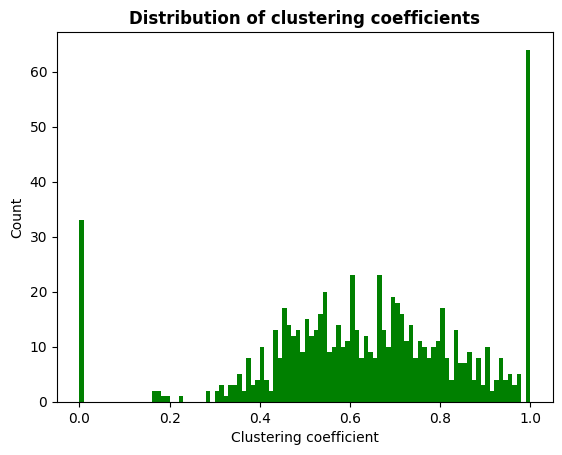

In [78]:
c_massive
num_bins = 100
n, bins, _ = plt.hist(c_massive, num_bins, color='green')
plt.xlabel('Clustering coefficient')
plt.ylabel('Count')
plt.title('Distribution of clustering coefficients', fontweight='bold')
plt.show()

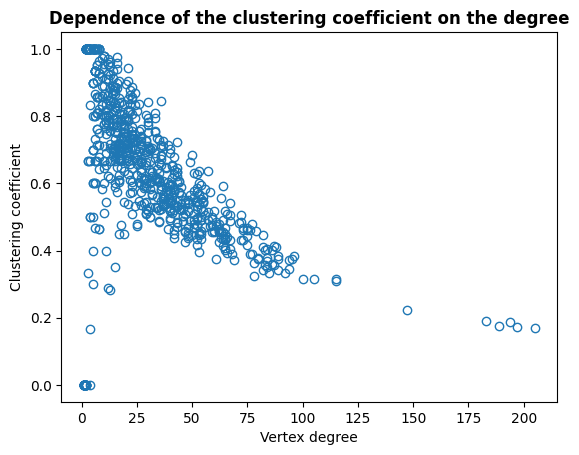

In [79]:
plt.plot(c_on_degree, c_massive, 'o', markerfacecolor='none')
plt.xlabel('Vertex degree')
plt.ylabel('Clustering coefficient')
plt.title('Dependence of the clustering coefficient on the degree', fontweight='bold')
plt.show()


### 1.2. Path length

- Calculate the average length of the shortest path between two vertices of the graph

- Plot a histogram of the dependence of the average length of the shortest path on the degree of the vertex

In [80]:
avg_lens = 0
G_lcc_nodes = list(G_lcc.nodes)
for v1_i in range(len(G_lcc.nodes)):
  for v2_i in range(v1_i + 1, len(G_lcc.nodes)):
    avg_lens += shortest_dist[G_lcc_nodes[v1_i]][G_lcc_nodes[v2_i]]
avg_lens /= (len(G_lcc.nodes) * (len(G_lcc.nodes) - 1) / 2)
print(f"Average shortest path between 2 nodes: {avg_lens}")

Average shortest path between 2 nodes: 3.0968329646572026


In [81]:
shotest_path_by_degree = dict()
for v in G_lcc.nodes:
  shotest_path_by_degree[G_lcc.degree(v)] = shotest_path_by_degree.get(G_lcc.degree(v), []) + list(shortest_dist[v].values())
for key in shotest_path_by_degree:
  shotest_path_by_degree[key] = sum(shotest_path_by_degree[key]) / len(shotest_path_by_degree[key])

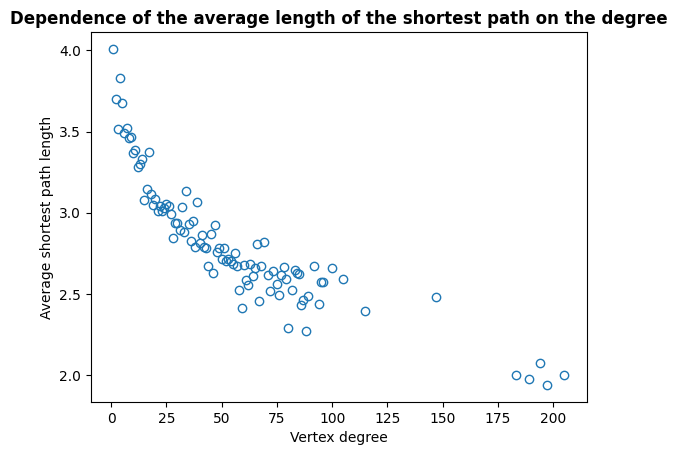

In [82]:
plt.plot(*zip(*sorted(shotest_path_by_degree.items())), 'o', markerfacecolor='none')
plt.xlabel('Vertex degree')
plt.ylabel('Average shortest path length')
plt.title('Dependence of the average length of the shortest path on the degree', fontweight='bold')
plt.show()

### 1.3. Distribution of node degrees

- What is the distribution of node degrees? Run goodness-of-fit test and estimate parameters of the distribution.

Проверим несколько предположений о распределении:

Возьмем: power law (Степенное), экспоненциальное и лог-нормальное

Для проверки степенного распределения воспользуемся двумя методами:

- Hill method
- Clauset-Shalizi-Newman method

Alpha: -1.129755751314778, C: -1.0264966149787877


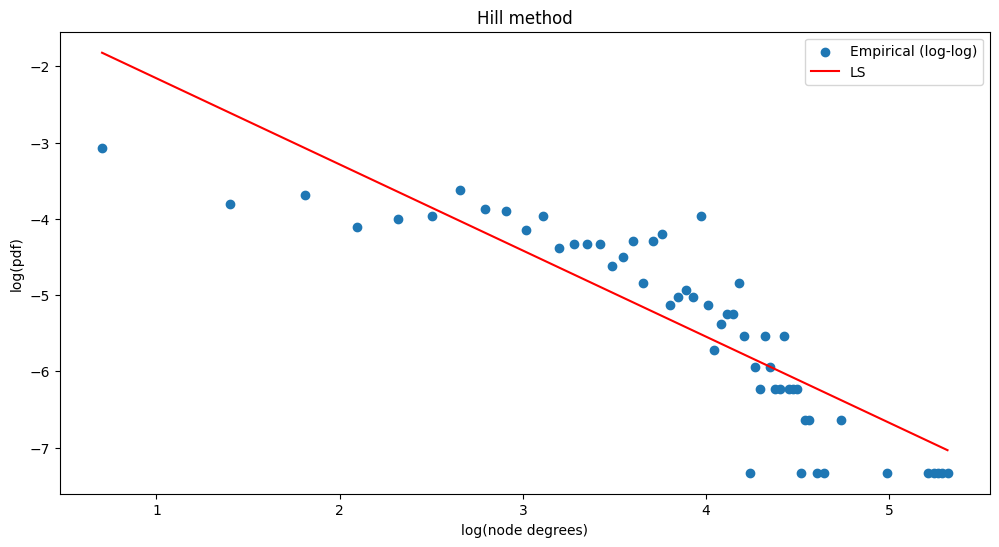

In [83]:
from sklearn import linear_model

degrees = [val for (node, val) in G_lcc.degree()]

pdf, bins = np.histogram(degrees, bins=100, density=True)
bin_centers = (bins[1:] + bins[:-1]) / 2

non_zeros = (pdf > 0) & (bin_centers > 0)

x = bin_centers[non_zeros]
y = pdf[non_zeros]

log_x = np.log(x)
log_y = np.log(y)

free_ = np.ones_like(log_x)
A = np.vstack([log_x, free_]).T

reg = linear_model.LinearRegression()

res = reg.fit(A, log_y)

print(f'Alpha: {res.coef_[0]}, C: {res.intercept_}')
fig, axs = plt.subplots(1,1,figsize=(12,6))
axs.scatter(log_x, log_y, label="Empirical (log-log)")
axs.plot(log_x, res.coef_[0]*log_x + res.intercept_, 'r', label="LS")

axs.set_xlabel("log(node degrees)")
axs.set_ylabel("log(pdf)")
axs.set_title("Hill method")
axs.legend()
plt.show()

По графику видно, что данные "примерно" ложаться на прямую, то есть отвергать powerlaw пока не будем.

Воспользуемся другим методом для проверки:

In [84]:
degrees = np.array([val for (node, val) in G_lcc.degree()])

In [85]:
def mle_pl(x, x_min):
    thrhld = x[x >= x_min]

    res = np.sum(np.log(thrhld/x_min))

    alpha = 1 + len(thrhld) / res

    return alpha

def ks_distance(x, x_min, alpha):
  x = np.sort(x)
  x = x[x >= x_min]

  F_emp = np.arange(1, len(x) + 1) / len(x)

  F_pl = power_law_cdf(x, x_min, alpha)

  ks = np.sqrt(len(x)) * np.max(np.abs(F_pl - F_emp))

  return ks

def power_law_cdf(x, x_min, alpha):
  res = 1 - (x / x_min) ** (-alpha + 1)
  return res

def get_params(x_s, xmins):
  res_x_min = None
  res_alpha = None
  res_ks = 1000000000

  for x_min in xmins:
    new_x = x_s[x_s >= x_min]

    alpha = mle_pl(new_x, x_min)

    ks = ks_distance(x_s, x_min, alpha)

    if ks < res_ks:
      res_ks = ks
      res_x_min = x_min
      res_alpha = alpha

  return res_alpha, res_x_min, res_ks

x = degrees

x_mins = np.unique(x)[10:50]
alpha, x_min, ks = get_params(x, x_mins)

Ограничение (x_min) подобрал перебором

In [86]:
print(f'alpha={alpha}, x_min={x_min}, ks={ks}')

alpha=4.262972659194663, x_min=50, ks=0.8750193092393179


Теперь проведем сам тест: будет использовать 1000 синтетических выборок

Для генерации powerlaw я использовал pareto, как нашел в одном из [примеров](https://towardsdatascience.com/detecting-power-laws-in-real-world-data-with-python-b464190fade6/)

In [87]:
def csn_test(x, alpha, x_min, ks):
  new_x = x[x >= x_min]

  ks_tests = list()

  for _ in range(1000):
    syntetic_x = (np.random.pareto(alpha, len(new_x)) + 1) * x_min
    alpha_1, x_min_1, ks_1 = get_params(syntetic_x, [x_min])
    ks_tests.append(ks_1)

  p_val = np.mean(np.array(ks_tests) > ks)
  print(f"x_min: {x_min}, alpha: {alpha}, p-val: {p_val}")

In [88]:
csn_test(degrees, alpha, x_min, ks)

x_min: 50, alpha: 4.262972659194663, p-val: 0.151


Получу p-val > 0.176 => не отвергаем powerlaw.

Для интереса проверим, что нам выдаст библиотека powerlaw

In [89]:
from scipy.stats import expon,lognorm, kstest

degrees = [val for (node, val) in G_lcc.degree()]

data = np.array(degrees)
results = powerlaw.Fit(data)
alpha = results.power_law.alpha
x_min = results.power_law.xmin
print(f'alpha = {alpha}, x_min = {x_min}')
D, p_val  = kstest(data, "powerlaw", args=(alpha, x_min))
print(f'powerlaw D: {D}, p_val: {p_val}')

Calculating best minimal value for power law fit
alpha = 4.881730367392734, x_min = 62.0
powerlaw D: 0.893048128342246, p_val: 0.0


Мы получили что-то отдаленно похожее на результат библиотеки (не считая p-value)

Проверим еще пару распределений (хотя мы уже знаем, что это powerlaw)

In [90]:
c_exp, s_exp = expon.fit(degrees, floc=0)

D, p_val = kstest(degrees, 'expon', args=(c_exp, s_exp))

print(f'exponential. D:{D}, p-value: {p_val}')

exponential. D:0.0712201833107769, p-value: 0.0009596899838594992


In [91]:
shape, location, scale = lognorm.fit(degrees)

D, p_val = kstest(degrees, 'lognorm', args=(shape, location, scale))

print(f'norm. D:{D}, p-value: {p_val}')

norm. D:0.055358158312494576, p-value: 0.019642069406488247


Делаем вывод, что наше распределение - powerlaw

### 1.4. Determine which are the most important and significant  neurons in our brain?

Можно смотреть на разные метрики в таком случае, например:

$\textbf{Degree centrality}$: $C_D(i) = \frac{K(i)}{N - 1}$ \
$\textbf{Closeness centrality}$: $C_C(i) = \frac{1}{\sum_{i\neq j}{e_{ij}}}$ \
$\textbf{Betweenness centrality}$: $C_B(i) = \sum_{h\neq i \neq j} \frac{σ_{hj}(i)}{σ_{hj}}$ \
$\textbf{Eigenvector centrality}$: $v_i = \frac{1}{\lambda} \sum_{j}{A_{ij}v_j}$


Исходя из каждой будет смотреть на топ 10 и считать, что они (по данной метрике) будут самыми важными

In [92]:
def plot_centrality(centrality, title=""):
  top10_nodes = sorted(centrality, key=centrality.get, reverse=True)[:10]
  print(*list(top10_nodes), sep="\n")
  colors_nodes = set(top10_nodes)

  plot_values = [(node, centrality[node]) for node in top10_nodes]

  for node in centrality:
      if node not in colors_nodes:
          centrality[node] = 0.0

  centrality = [centrality[node] for node in G_lcc.nodes()]

  orig_node_colors = get_node_colors([
      canonize_key(data.get(color_by, 'Unknown'))
      for node, data in G_lcc.nodes(data=True)
  ])

  node_colors = [
      orig_color if node in colors_nodes else "rgba(200,200,200,0.01)"
      for (node, orig_color) in zip(G_lcc.nodes(), orig_node_colors)
  ]

  node_sizes = [
      min(30, 10 + int(node) / len(G_lcc) * 10) if node in colors_nodes else 3
      for node in G_lcc.nodes()
  ]

  plot_connectome(G_lcc, node_colors=node_colors, values=centrality, node_sizes=node_sizes, plot_values=plot_values, title=title)


In [93]:
degree_centrality = dict()
for node in G_lcc.nodes:
  result = G_lcc.degree(node) / (len(G_lcc) - 1)
  degree_centrality[node] = (result)
plot_centrality(degree_centrality, "Degree centrality")

503
1008
504
502
1009
1010
505
770
487
127


In [94]:
# будем использовать нормализованную https://en.wikipedia.org/wiki/Closeness_centrality
closeness_centrality = dict()
for node in G_lcc.nodes:
  result = (len(G_lcc) - 1) / sum(shortest_dist[node].values())
  closeness_centrality[node] = (result)

plot_centrality(closeness_centrality, "Сloseness centrality")

1008
502
1009
503
504
770
699
285
202
291


In [95]:
betweenness_centrality = nx.betweenness_centrality(G_lcc)
plot_centrality(betweenness_centrality, "Betweenness centrality")

1008
502
1009
503
504
1013
1010
385
770
751


In [96]:
eigenvector_centrality = nx.eigenvector_centrality(G_lcc)
plot_centrality(eigenvector_centrality, "Eigenvector centrality")

502
503
1008
504
1009
505
1010
770
487
285


Можно отметить, что в списках есть много повторяющихся

Тогда, в общем случае, самыми важными будут:
- Нейрон 1008
- Нейрон 502
- Нейрон 503


### 1.5. Is the human brain a complex network? Why?

In [97]:
for i in ["60", "250", "500"]:
  graph_path_tmp = osp.join(".", f"brain_scale{i}.graphml")
  G_tmp = nx.read_graphml(graph_path_tmp)
  lcc_tmp = max(nx.connected_components(G_tmp), key=len)
  G_lcc_tmp = G_tmp.subgraph(lcc_tmp).copy()

  print(f"Original Graph length: {len(G_tmp.nodes())}")
  print(f"Graph Largest Component length: {len(G_lcc_tmp.nodes())}")

Original Graph length: 129
Graph Largest Component length: 110
Original Graph length: 463
Graph Largest Component length: 370
Original Graph length: 1015
Graph Largest Component length: 748


In [98]:
print(f'Max degree (hubs): {sorted(degrees)[-5:]}. Mean degree: {np.mean(degrees)}')

Max degree (hubs): [183, 189, 194, 197, 205]. Mean degree: 30.109625668449198


Проверим по определяем сложной сети:

- Наличие хабов. В сложных сетях присутствуют хабы, как и в нашем случае;

- Степенной закон. Сложные сети (не всегда, но как правило) следуют степенному закому. В нашем случае мы видим, что распределение - степенное;

- Наличие GCC (Гигантской компоненты связанности), которая растет с ростом самого графа. Как видно из результата кода выше - с ростом числа узлов растет и наша максимальная компонента.

Исходя из этих данных можно сделать вывод, что мозг - сложная сеть.



## Problem 2. Labeling of the brain connectome (30 points)

- Create an automatic labeling of the brain's connectome. Labeling refers to the division of connections into a number of groups, and the assignment of each vertex to one of these groups.

- Try several different labeling algorithms and describe how you chose the values for their parameters.

- Compare the results of the different algorithms to each other and to the original labeling.

Попробуем несколько видов labeling.
- Louvain method
- Label propogation
- Async Label propogation


In [99]:
def plot_communities(communities, title):
  communities_dict = dict()

  for i, cluster in enumerate(communities):
    for node in cluster:
      communities_dict[node] = i

  node_labels = list()

  for node in G_lcc.nodes:
    node_labels.append(communities_dict[node])

  node_colors = get_node_colors(node_labels)

  plot_connectome(G_lcc, node_colors=node_colors, title=title, legend=False)

In [100]:
louvain_communities = nx.community.louvain_communities(G_lcc)
plot_communities(louvain_communities, "Louvain communities")

In [101]:
label_propagation_communities = nx.community.label_propagation_communities(G_lcc)
plot_communities(label_propagation_communities, "Label propagation communities")


In [102]:
asyn_lpa_communities = nx.community.asyn_lpa_communities(G_lcc)
plot_communities(asyn_lpa_communities, "asyn_lpa_communities")

После того, как мы получили разбиения на кластеры нужно понять - насколько хорошо мы их разбили?

Будем использовать формулу модальности

$\frac{Q}{Q_{max}} = \frac{\sum_{ij}(A_{ij} - \frac{k_i k_j}{2m})\delta (c_i, c_j)}{2m - \sum_{ij} \frac{k_i k_j}{2m} \delta(c_i, c_j)}$

In [103]:
def get_modularity_coef(Graph, communities):
  communities_dict = dict()

  for i, cluster in enumerate(communities):
    for node in cluster:
      communities_dict[node] = i

  labels = list()

  for node in G_lcc.nodes:
    labels.append(communities_dict[node])

  A = nx.to_numpy_array(Graph)

  k = np.array([Graph.degree(node) for node in list(Graph.nodes)])

  m = Graph.number_of_edges()

  labels = np.array(labels)

  delta_i_j = (labels == labels[:, None])

  tmp = np.outer(k, k) / (2*m)

  res = np.sum((A - tmp) * delta_i_j) /(2 * m - np.sum(tmp * delta_i_j))

  return res

Посмотрим на результаты для оригинального разбиения и для автоматический разметок

In [104]:
print(f"louvain_communities, Q = {get_modularity_coef(G_lcc, louvain_communities)}")
print(f"label_propagation_communities, Q = {get_modularity_coef(G_lcc, label_propagation_communities)}")
asyn_lpa_communities = nx.community.asyn_lpa_communities(G_lcc)
print(f"asyn_lpa_communities, Q = {get_modularity_coef(G_lcc, asyn_lpa_communities)}")

# для оригинального лейболинга нужно немного преобразовать
tmp_dict = dict()

for node, data in G_lcc.nodes(data=True):
   ck = canonize_key(data.get(color_by, 'Unknown'))
   if ck not in tmp_dict:
      tmp_dict[ck] = set()
   tmp_dict[ck].add(node)

print(f"original, Q = {get_modularity_coef(G_lcc, tmp_dict.values())}")

louvain_communities, Q = 0.7991947360451042
label_propagation_communities, Q = 0.8312916324186914
asyn_lpa_communities, Q = 0.8759632084670059
original, Q = 0.1856357718925842


Можно заметить, что в оригинальной разметке (биологической), коэффициент модулярности оказался очень низким. Это, на самом деле, не очень удивительно, так как модулярность учитывает то, насколько плотными связями обладают группы и "штрафует" за сильные связи между группами. В мозге, как мы выяснили только что, отдельные группы нейронов достаточно сильно контактируют между собой.

Для автоматический разметок можно сделать такой вывод:
- лучшим (из рассмотренных) является asyn_lpa_communities, хотя он является достаточно простым
- биологическая разметка оказалась самой "худшей"

Однако сейчас мы смотрели на показатель качества разметок, но никак не учли то, а насколько методы кластеризации хорошо объясняют биологию.
Для этого сравним результаты автоматических разметок и оригинальной.
Способов сравнения [сущесвует несколько](https://neerc.ifmo.ru/wiki/index.php?title=%D0%9E%D1%86%D0%B5%D0%BD%D0%BA%D0%B0_%D0%BA%D0%B0%D1%87%D0%B5%D1%81%D1%82%D0%B2%D0%B0_%D0%B2_%D0%B7%D0%B0%D0%B4%D0%B0%D1%87%D0%B5_%D0%BA%D0%BB%D0%B0%D1%81%D1%82%D0%B5%D1%80%D0%B8%D0%B7%D0%B0%D1%86%D0%B8%D0%B8)

Выберем несколько метрик для сравнения с оригинальной разметкой


In [105]:
def get_list_from_dict(communities):
  communities_dict = dict()

  for i, cluster in enumerate(communities):
    for node in cluster:
      communities_dict[node] = i

  node_labels = list()

  for node in G_lcc.nodes:
    node_labels.append(communities_dict[node])

  return node_labels

In [106]:
orig_labels = get_list_from_dict(tmp_dict.values())
louvain_labels = get_list_from_dict(louvain_communities)
label_propagation_labels = get_list_from_dict(label_propagation_communities)
asyn_lpa_communities = nx.community.asyn_lpa_communities(G_lcc)
asyn_lpa_labels = get_list_from_dict(asyn_lpa_communities)

In [107]:
from sklearn.metrics.cluster import rand_score
from sklearn.metrics.cluster import adjusted_rand_score, fowlkes_mallows_score


def compare(label_texts, function, values):
  for label_text, value in zip(label_texts, values):
    print(f'{label_text}: {function(orig_labels, value)}')
  print('\n')

print('Сравнение по Adjusted Rand')
texts = ["louvain_labels", "label_propagation_labels", "asyn_lpa_labels"]
vals = [louvain_labels, label_propagation_labels, asyn_lpa_labels]
compare(texts, adjusted_rand_score, vals)

print('Сравнение по Fowlkes Mallows Score')
texts = ["louvain_labels", "label_propagation_labels", "asyn_lpa_labels"]
vals = [louvain_labels, label_propagation_labels, asyn_lpa_labels]
compare(texts, fowlkes_mallows_score, vals)

Сравнение по Adjusted Rand
louvain_labels: 0.09348730297469783
label_propagation_labels: 0.05021689036053023
asyn_lpa_labels: 0.055282816441621564


Сравнение по Fowlkes Mallows Score
louvain_labels: 0.21545224465284693
label_propagation_labels: 0.18524199326007398
asyn_lpa_labels: 0.18797614614710206




Видим, что базовые алгоритмы (без подбора параметров) показывают очень низкое соответсвие с оригинальной разметкой.

Подберем параметры для разбиений:

In [108]:
resolutions = np.logspace(0.01, 1.0, num=30)
scores = list()
for r in resolutions:
  louvain_communities = nx.community.louvain_communities(G_lcc, resolution=r)
  louvain_labels = get_list_from_dict(louvain_communities)
  score = adjusted_rand_score(orig_labels, louvain_labels)
  scores.append(score)

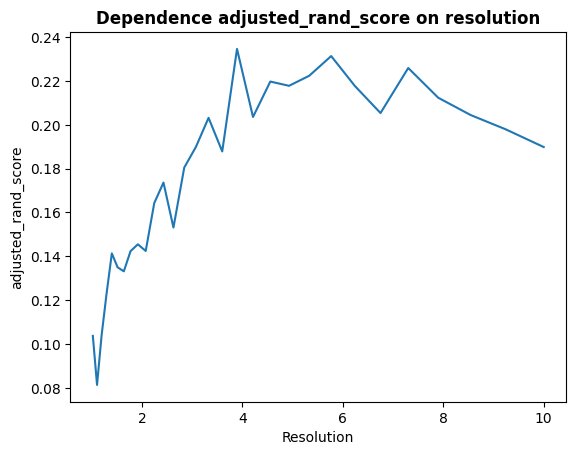

In [109]:
plt.plot(resolutions, scores)
plt.xlabel('Resolution')
plt.ylabel('adjusted_rand_score')
plt.title('Dependence adjusted_rand_score on resolution', fontweight='bold')
plt.show()

In [110]:
print(f"Лучший resolution: {resolutions[scores.index(max(scores))]}")
print(f"Лучший adjusted_rand_score: {max(scores)}")

Лучший resolution: 3.8935416750448666
Лучший adjusted_rand_score: 0.23461708938784095


## Problem 3. Assortativity (15 points)

- Рассмотрите:
  - Коннектом целиком
  - Различные области, найденные с помощью автоматической разметки, по отдельности
- Посчитайте для них ассортативность, постройте необходимые графики
- Проанализируйте результаты
- Consider:
  - Connect as a whole
  - Various areas found using automatic labeing individually
- Calculate the assortativity for them, plot the necessary graphs
- Analyze the results

Посмотрим на коэф. Assortativity.

Есть определение линейного коэффициента:

Assortativity coefficient

$r = \frac{\sum_{ij}{A_{ij}(k_i - <k>)(k_j - <k>)}}{\sum_{ij}A_{ij}{(k_i - <k>)^2}}$


In [111]:
def calculate_pearson_correlation_coefficient(Graph):
  A = nx.to_numpy_array(Graph)

  k = np.array(list(dict(Graph.degree).values()))

  k_i_m = k - np.mean(k)

  k_i_j = np.outer(k_i_m, k_i_m)

  res = np.sum(A * k_i_j) / np.sum(A * (k_i_m[:, None] ** 2))

  return res

In [112]:
calculate_pearson_correlation_coefficient(G_lcc)

np.float64(0.25676455347726257)

Как видим в нашем случае он получился достаточно высоким (Assortativity)

Теперь воспользуемся Pearson correlation

Посчитаем коэффициент Assortativity для всего графа

In [113]:
nx.degree_assortativity_coefficient(G_lcc)

-0.023608654977695178

Коэффициент близок к нулю, то есть сеть скорее не Assortativity и не Disassortativity

Но так как коэффициент < 0 - больше склоняется к Disassortativity, то есть вершины с малеькой степенью скорее соединяются с вершинами с большой степенью и наоборот.

Это подтверждается [наблюдениями](https://ru.wikipedia.org/wiki/%D0%9A%D0%BE%D0%BC%D0%BF%D0%BB%D0%B5%D0%BA%D1%81%D0%BD%D1%8B%D0%B5_%D1%81%D0%B5%D1%82%D0%B8), что сети, связанные с биологическими явлениями скорее диссарциативны

Посмотрим для каждого кластера каждого метода его коэфициент ассортативности

In [114]:
scores_louvain = list()
for cluster in louvain_communities:
  res = nx.degree_assortativity_coefficient(G_lcc.subgraph(list(cluster)))
  if np.isnan(res):
    res = 0.0
  scores_louvain.append(res)

scores_label_propagation_communities = list()
for cluster in label_propagation_communities:
  res = nx.degree_assortativity_coefficient(G_lcc.subgraph(list(cluster)))
  if np.isnan(res):
    res = 0.0
  scores_label_propagation_communities.append(res)

scores_asyn_lpa_communities = list()
asyn_lpa_communities = nx.community.asyn_lpa_communities(G_lcc)
for cluster in asyn_lpa_communities:
  res = nx.degree_assortativity_coefficient(G_lcc.subgraph(list(cluster)))
  if np.isnan(res):
    res = 0.0
  scores_asyn_lpa_communities.append(res)

scores_orig = list()
orig_communities = tmp_dict.values()
for cluster in orig_communities:
  res = nx.degree_assortativity_coefficient(G_lcc.subgraph(list(cluster)))
  if np.isnan(res):
    res = 0.0
  scores_orig.append(res)

/usr/local/lib/python3.12/dist-packages/networkx/algorithms/assortativity/mixing.py:217: RuntimeWarning:

invalid value encountered in divide

/usr/local/lib/python3.12/dist-packages/networkx/algorithms/assortativity/correlation.py:302: RuntimeWarning:

invalid value encountered in scalar divide



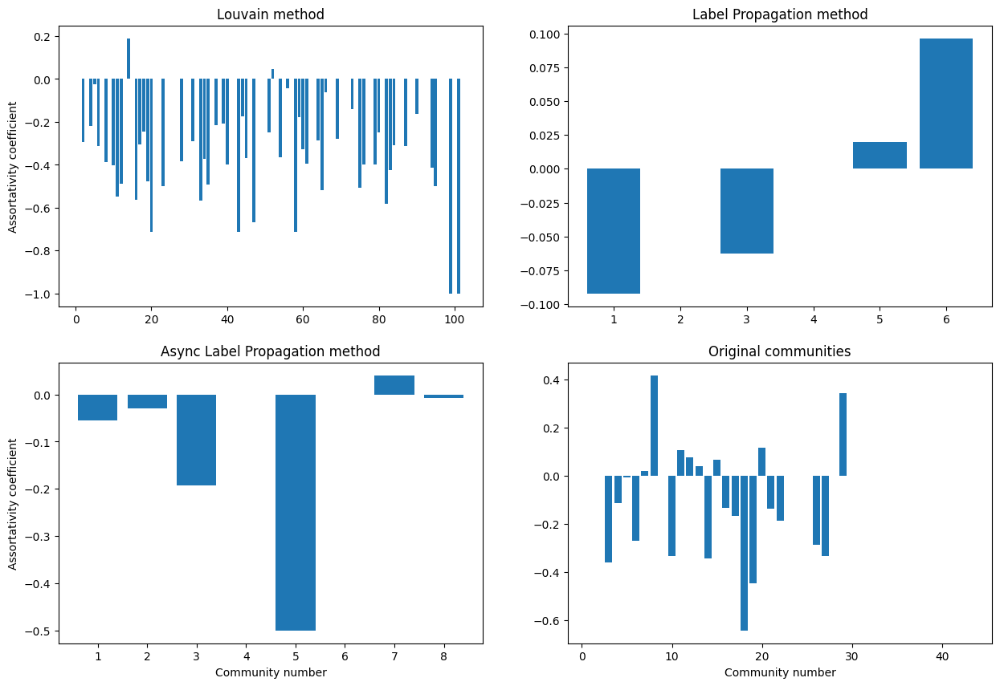

In [115]:
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

labels_louvain = np.arange(len(scores_louvain)) + 1
axes[0][0].bar(labels_louvain, scores_louvain)
axes[0][0].set_title('Louvain method')
axes[0][0].set_ylabel('Assortativity coefficient')

labels_label_propagation_communities = np.arange(len(scores_label_propagation_communities)) + 1

axes[0][1].bar(labels_label_propagation_communities, scores_label_propagation_communities)
axes[0][1].set_title('Label Propagation method')

labels_scores_asyn_lpa_communities = np.arange(len(scores_asyn_lpa_communities)) + 1
axes[1][0].bar(labels_scores_asyn_lpa_communities, scores_asyn_lpa_communities)
axes[1][0].set_title('Async Label Propagation method')
axes[1][0].set_ylabel('Assortativity coefficient')
axes[1][0].set_xlabel('Community number')

labels_scores_orig = np.arange(len(scores_orig)) + 1
axes[1][1].bar(labels_scores_orig, scores_orig)
axes[1][1].set_title('Original communities')
axes[1][1].set_xlabel('Community number')

plt.show()

В случае автоматический разметок - больше сообществ получилось с коэффициентом <0 (то есть сообщества внутри disassortativity).

В случае с оригинальной разметкой - disassortativity кластеры также преобладают, но assortativity кластеров значительно больше




Также можно посмотреть по assortativity по аттрибутам:

In [116]:
nx.attribute_assortativity_coefficient(G_lcc,'dn_name')

-0.0024027248664880226

## Problem 4. Transcranial magnetic stimulation (30 points)

__[Transcranial magnetic stimulation (TMS)](https://en.wikipedia.org/wiki/Transcranial_magnetic_stimulation)__ - a method that allows noninvasively stimulating the cerebral cortex. It is used for the rehabilitation of patients (for example, with motor disorders), and for the treatment of various diseases: Parkinson's disease, epilepsy, depression, schizophrenia, and others.

We would like to suggest that you conduct a TMS on your "patient". For this, you will need:

- "Weigh" the edges of the graph. For example, using some metric that decreases with increasing distance between vertices.

- Apply TMS to different areas of the brain. See how far the signal will spread, which areas it will affect, and what functions these areas are responsible for.

  Various methods can be used to implement signal propagation: `message passing', `random walk', `heat diffusion' and others.

  Try different methods (two or more), compare the results.

---

To determine which areas of the brain should be targeted with TMS, you can refer to scientific articles. For example:

__[Evidence-based guidelines on the therapeutic use of repetitive transcranial magnetic stimulation (rTMS)](https://www.sciencedirect.com/science/article/pii/S1388245719312799?via%3Dihub)__.

This article contains many studies that stimulated various areas of the brain using TMS. It also describes the symptoms of patients and the results of TMS use.

---

For example, in the picture below you can see:

- The patient's symptom is a motor disorder of the hand as a result of stroke.

- The area of application of TMS is the M1 zone. You can use a __[map of brain regions](https://atlas.brain-map.org/atlas?atlas=265297126)__ to orient yourself in the areas of a brain.

- The result of the therapy is an improvement in the patient's motor functions.

---

Good luck!

Сначала взвесим ребра графа, это этого будет использовать обратное (1/...) евклидово расстояние между вершинами, так как у нас есть координаты каждой вершины



In [117]:
def get_weight_of_graph(Graph):
  w = dict()
  nodes = G_lcc.nodes()
  for edge in G_lcc.edges():
    x_1 = nodes[edge[0]]['dn_position_x']
    y_1 = nodes[edge[0]]['dn_position_y']
    z_1 = nodes[edge[0]]['dn_position_z']

    x_2 = nodes[edge[1]]['dn_position_x']
    y_2 = nodes[edge[1]]['dn_position_y']
    z_2 = nodes[edge[1]]['dn_position_z']

    dist = np.sqrt((x_2 - x_1) ** 2 + (y_2 - y_1) ** 2 + (z_2 - z_1) ** 2)

    if edge[0] not in w:
      w[edge[0]] = dict()
    if edge[1] not in w:
      w[edge[1]] = dict()

    w[edge[0]][edge[1]] = 1.0/dist
    w[edge[1]][edge[0]] = 1.0/dist

  return w

weights = get_weight_of_graph(G_lcc)

Рассмотрим сначала алгоритм random walk

Реализуем алгоритм random walk

Его суть в том, что в конкретный момент из вершины $v_1$ можно пойти в соседей исходя из вероятности.

$P(v_1, v_2) = \frac{E(v_1, v_2)}{\sum_{v \in neig(v_1)}{E(v_1, v)}}$ ([Отсюда](https://home.icts.res.in/~rbasu/TIDP(1).pdf))

In [118]:
# пусть он тут отдает путь, по которому идет

def random_walk(weights, current, iters=10):
  path = [current]

  for iter in range(iters):
    if len(weights[current]) == 0:
      break
    dist_sum = sum(weights[current].values())
    vals = np.array(list(weights[current].values())) / dist_sum
    items = list(weights[current].keys())
    next = np.random.choice(items, 1, p=vals)[0]
    path.append(str(next))
    current = next

  return path

In [119]:
def plot_tms(tms_result, title=""):
  colors_nodes = set(tms_result)
  values = [0 for node in G_lcc.nodes()]

  orig_node_colors = get_node_colors([
      canonize_key(data.get(color_by, 'Unknown'))
      for node, data in G_lcc.nodes(data=True)
  ])

  node_colors = [
      orig_color if node in colors_nodes else "rgba(200,200,200,0.01)"
      for (node, orig_color) in zip(G_lcc.nodes(), orig_node_colors)
  ]

  node_sizes = [
     30 if node in colors_nodes else 3
      for node in G_lcc.nodes()
  ]

  plot_connectome(G_lcc, node_colors=node_colors, values=values, node_sizes=node_sizes, title=title)

In [129]:
plot_tms(random_walk(weights, '3'), "Random Walk")

Теперь перейдем к стимуляции TMS. Для этого выберем какой-то из результатов и посмотрим, что нужно стимулировать

Возьмем данные из

> Table 2. HF-rTMS of bilateral M1 regions in Parkinson’s disease (motor symptoms).




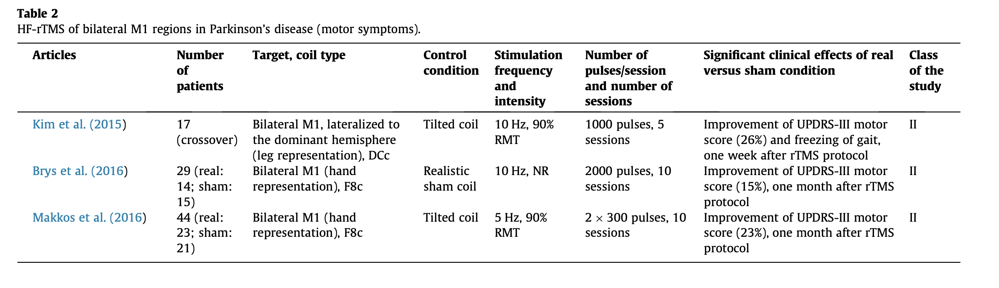

Возьмем первое исследование

Возьмем ту область, которая отвечает за ноги из нашей таблицы

> "Paracentral": "Control of leg and trunk movements",




Нам потребуется несколько функций для того, что извлечь нужны нейроны из области:

In [120]:
def get_neuron(area, Graph):
  color_by='dn_name'
  neurons = list()
  for node, data in Graph.nodes(data=True):
    name = canonize_key(data.get(color_by, 'Unknown'))
    if name == area:
      neurons.append(node)
  return neurons

def get_areas_of_brain(neurons, Graph):
  areas = dict()
  nodes = G_lcc.nodes(data=True)
  for i in neurons:
    areas[canonize_key(nodes[i]['dn_fsname'])] = areas.get(canonize_key(nodes[i]['dn_fsname']), 0) + 1
  for key in areas.keys():
    areas[key] = areas[key] / len(neurons)
  return areas

Создадим и саму стимуляцию (TMS)

In [121]:
def make_tms(Graph, weigths, area, func):
  neurons = get_neuron(area, Graph)[:10]
  path = []
  for i in range(len(neurons)):
    path.extend(func(weigths, neurons[i]))
  return path

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15],
 [Text(0, 0, 'Paracentral'),
  Text(1, 0, 'Postcentral'),
  Text(2, 0, 'Precentral'),
  Text(3, 0, 'Insula'),
  Text(4, 0, 'Right-hippocampus'),
  Text(5, 0, 'Precuneus'),
  Text(6, 0, 'Bankssts'),
  Text(7, 0, 'Inferiorparietal'),
  Text(8, 0, 'Superiorparietal'),
  Text(9, 0, 'Caudalmiddlefrontal'),
  Text(10, 0, 'Rostralmiddlefrontal'),
  Text(11, 0, 'Superiorfrontal'),
  Text(12, 0, 'Posteriorcingulate'),
  Text(13, 0, 'Supramarginal'),
  Text(14, 0, 'Isthmuscingulate'),
  Text(15, 0, 'Parsopercularis')])

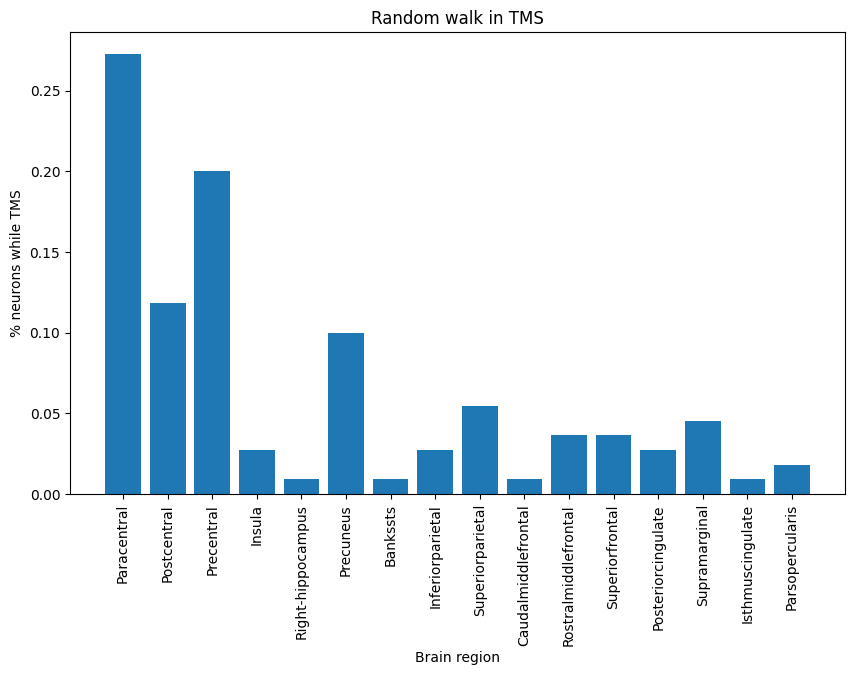

In [122]:
res = make_tms(G_lcc, weights, 'Paracentral', random_walk)
result_random_walk = get_areas_of_brain(res, G_lcc)
plt.figure(figsize=(10, 6))
plt.bar(result_random_walk.keys(), result_random_walk.values())
plt.xlabel('Brain region')
plt.ylabel('% neurons while TMS')
plt.title('Random walk in TMS')
plt.xticks(rotation=90)

Видно, что простимулированны оказались как раз те отделы мозга, которые отвечают за движения

Теперь перейдем в алгоритму message_passing

In [123]:
def message_passing(weights, start, iters=5):
  nodes = list(weights.keys())

  tmp_indexes = {nodes[i]: i for i in range(len(nodes))}

  weight_matrix = np.zeros((len(nodes), len(nodes)))
  for v1 in nodes:
    for v2, w in weights[v1].items():
      weight_matrix[tmp_indexes[v1], tmp_indexes[v2]] = w

  state_matrix = np.zeros(len(nodes))
  state_matrix[tmp_indexes[start]] = 1.0

  for _ in range(iters):
    state_matrix = weight_matrix.T @ state_matrix
    state_matrix /= state_matrix.sum()

  res = {nodes[i]: state_matrix[i] for i in range(len(nodes))}
  return res

In [124]:
def plot_message_passing(res, title=""):
  nodes = sorted(res, key=res.get, reverse=True)
  colors_nodes = set(nodes)

  vals = [0 for node in G_lcc.nodes()]

  orig_node_colors = get_node_colors([
      canonize_key(data.get(color_by, 'Unknown'))
      for node, data in G_lcc.nodes(data=True)
  ])

  node_colors = [
      orig_color if node in colors_nodes else "rgba(200,200,200,0.01)"
      for (node, orig_color) in zip(G_lcc.nodes(), orig_node_colors)
  ]

  node_sizes = [
      min(40, 10 + int(node) / len(G_lcc) * 10) if node in colors_nodes else 3
      for node in G_lcc.nodes()
  ]

  plot_connectome(G_lcc, node_colors=node_colors, values=vals, node_sizes=node_sizes, title=title)

In [125]:
plot_message_passing(message_passing(weights, '3'), title="Message passing")

In [126]:
def get_mean_vals_per_region(results, Graph):
  areas = dict()
  nodes = G_lcc.nodes(data=True)
  for i, v in results.items():
    name = canonize_key(nodes[i]['dn_fsname'])
    if name not in areas:
      areas[name] = np.array([])
    areas[name] = np.append(areas[name], v)
  for key in areas.keys():
   areas[key] = np.mean(areas[key])
  return areas

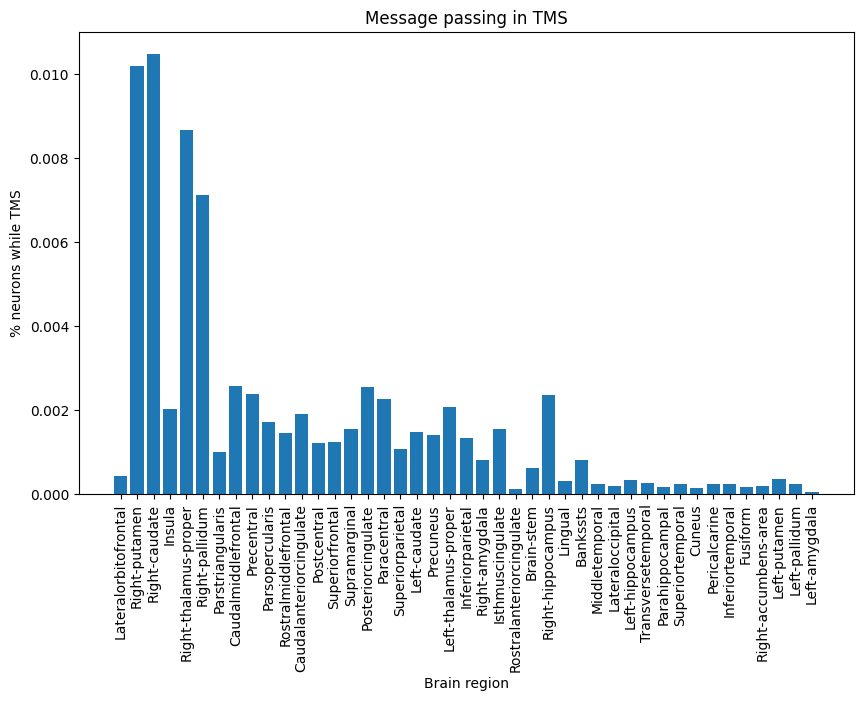

In [127]:
start = get_neuron('Paracentral', G_lcc)[3]
res = message_passing(weights, start)
result_mp = get_mean_vals_per_region(res, G_lcc)

plt.figure(figsize=(10, 6))
plt.bar(result_mp.keys(), result_mp.values())
plt.xlabel('Brain region')
plt.ylabel('% neurons while TMS')
plt.title('Message passing in TMS')
plt.xticks(rotation=90)
res = message_passing(weights, start)
result_mp = get_mean_vals_per_region(res, G_lcc)

Right-putamen: "Movement, skill formation",

Right-caudate: "Movement control, training",

Right-thalamus-proper: "Transmission of sensory signals to the cortex"



Результаты разнятся, но оба активизировали моторные отделы мозга.